In [27]:
from sklearn.datasets import make_blobs
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.cluster import KMeans
import seaborn as sns
from sklearn.metrics import silhouette_score
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
np.set_printoptions(threshold=np.inf, linewidth=np.inf)

In [28]:

data = pd.read_csv("weatherHistory.csv")
data

,Formatted Date,Summary,Precip Type,Temperature (C),Apparent Temperature (C),Humidity,Wind Speed (km/h),Wind Bearing (degrees),Visibility (km),Loud Cover,Pressure (millibars),Daily Summary
0,2006-04-01 00:00:00.000 +0200,Partly Cloudy,rain,9.472222,7.388889,0.89,14.1197,251.0,15.8263,0.0,1015.13,Partly cloudy throughout the day.
1,2006-04-01 01:00:00.000 +0200,Partly Cloudy,rain,9.355556,7.227778,0.86,14.2646,259.0,15.8263,0.0,1015.63,Partly cloudy throughout the day.
2,2006-04-01 02:00:00.000 +0200,Mostly Cloudy,rain,9.377778,9.377778,0.89,3.9284,204.0,14.9569,0.0,1015.94,Partly cloudy throughout the day.
3,2006-04-01 03:00:00.000 +0200,Partly Cloudy,rain,8.288889,5.944444,0.83,14.1036,269.0,15.8263,0.0,1016.41,Partly cloudy throughout the day.
4,2006-04-01 04:00:00.000 +0200,Mostly Cloudy,rain,8.755556,6.977778,0.83,11.0446,259.0,15.8263,0.0,1016.51,Partly cloudy throughout the day.
...,...,...,...,...,...,...,...,...,...,...,...,...
96448,2016-09-09 19:00:00.000 +0200,Partly Cloudy,rain,26.016667,26.016667,0.43,10.9963,31.0,16.1000,0.0,1014.36,Partly cloudy starting in the morning.
96449,2016-09-09 20:00:00.000 +0200,Partly Cloudy,rain,24.583333,24.583333,0.48,10.0947,20.0,15.5526,0.0,1015.16,Partly cloudy starting in the morning.
96450,2016-09-09 21:00:00.000 +0200,Partly Cloudy,rain,22.038889,22.038889,0.56,8.9838,30.0,16.1000,0.0,1015.66,Partly cloudy starting in the morning.
96451,2016-09-09 22:00:00.000 +0200,Partly Cloudy,rain,21.522222,21.522222,0.60,10.5294,20.0,16.1000,0.0,1015.95,Partly cloudy starting in the morning.


In [29]:
data["Precip Type"].unique(), data["Summary"].unique(), data["Daily Summary"].unique()

(array(['rain', 'snow', nan], dtype=object),
 array(['Partly Cloudy', 'Mostly Cloudy', 'Overcast', 'Foggy', 'Breezy and Mostly Cloudy', 'Clear', 'Breezy and Partly Cloudy', 'Breezy and Overcast', 'Humid and Mostly Cloudy', 'Humid and Partly Cloudy', 'Windy and Foggy', 'Windy and Overcast', 'Breezy and Foggy', 'Windy and Partly Cloudy', 'Breezy', 'Dry and Partly Cloudy', 'Windy and Mostly Cloudy', 'Dangerously Windy and Partly Cloudy', 'Dry', 'Windy', 'Humid and Overcast', 'Light Rain', 'Drizzle', 'Windy and Dry', 'Dry and Mostly Cloudy', 'Breezy and Dry', 'Rain'], dtype=object),
 array(['Partly cloudy throughout the day.', 'Mostly cloudy throughout the day.', 'Foggy in the evening.', 'Foggy overnight and breezy in the morning.', 'Overcast throughout the day.', 'Partly cloudy until night.', 'Mostly cloudy until night.', 'Foggy starting overnight continuing until morning.', 'Foggy in the morning.', 'Partly cloudy until evening.', 'Partly cloudy starting in the morning.', 'Mostly cloudy s

# Preprosesamiento

In [30]:
df_encoded = data.copy()

- Conversion de variables categoricas

Codificamos la precipitacion en "Llovio" o "Nevo"

In [31]:
df_encoded = pd.get_dummies(data, columns=['Precip Type'], prefix='Precip')

In [32]:
df_encoded[["Precip_rain", "Precip_snow"]].sample(10)

,Precip_rain,Precip_snow
48382,True,False
70969,True,False
80859,False,True
86229,True,False
26945,True,False
38006,True,False
25122,True,False
90183,True,False
95777,True,False
17920,True,False


Codificamos la categoria "Summary" puntuado segun nubosidad, intensidad de viento, humedad y precipitacion

In [33]:
cloudy_map = {
    'Clear': 0,
    'Partly Cloudy': 1,
    'Mostly Cloudy': 2,
    'Overcast': 3,
    'Foggy': 4
}

wind_map = {
    'None': 0,
    'Breezy': 1,
    'Windy': 2,
    'Dangerously Windy': 3
}
humidity_map = {
    'None': 0,
    'Dry': 1,
    'Humid': 2
}

precip_map = {
    'None': 0,
    'Drizzle': 1,
    'Light Rain': 2,
    'Rain': 3
}

def extract_features(summary):
    cloud = None
    wind = 'None'
    humidity = 'None'
    precip = 'None'
  
    for cloud_type in ['Clear', 'Partly Cloudy', 'Mostly Cloudy', 'Overcast', 'Foggy']:
        if cloud_type in summary:
            cloud = cloud_type
            break
    
    # Buscar componente de viento
    if 'Dangerously Windy' in summary:
        wind = 'Dangerously Windy'
    elif 'Windy' in summary:
        wind = 'Windy'
    elif 'Breezy' in summary:
        wind = 'Breezy'
    
    # Buscar componente de humedad
    if 'Humid' in summary:
        humidity = 'Humid'
    elif 'Dry' in summary:
        humidity = 'Dry'
    
    # Buscar componente de precipitación
    if 'Rain' in summary and 'Light' not in summary:
        precip = 'Rain'
    elif 'Light Rain' in summary:
        precip = 'Light Rain'
    elif 'Drizzle' in summary:
        precip = 'Drizzle'
    
    return cloud, wind, humidity, precip

# Aplicar la función a cada resumen
df_encoded['cloud_value_hour'] = data['Summary'].apply(lambda x: cloudy_map.get(extract_features(x)[0], 0))
df_encoded['wind_value_hour'] = data['Summary'].apply(lambda x: wind_map.get(extract_features(x)[1], 0))
df_encoded['humidity_value_hour'] = data['Summary'].apply(lambda x: humidity_map.get(extract_features(x)[2], 0))
df_encoded['precip_value_hour'] = data['Summary'].apply(lambda x: precip_map.get(extract_features(x)[3], 0))

In [34]:
df_encoded[["Summary", "cloud_value_hour", "wind_value_hour", "humidity_value_hour", "precip_value_hour"]].sample(10)

,Summary,cloud_value_hour,wind_value_hour,humidity_value_hour,precip_value_hour
54909,Foggy,4,0,0,0
12459,Mostly Cloudy,2,0,0,0
4882,Clear,0,0,0,0
75482,Mostly Cloudy,2,0,0,0
44750,Partly Cloudy,1,0,0,0
16563,Foggy,4,0,0,0
94003,Mostly Cloudy,2,0,0,0
6303,Breezy and Partly Cloudy,1,1,0,0
14300,Partly Cloudy,1,0,0,0
18600,Clear,0,0,0,0


Convertimos la columna de fecha en la etiqueta considerando solo las horas del dia

In [35]:
# Primero extraemos el mes como ya lo estabas haciendo
df_encoded['Formatted Date'] = pd.to_datetime(
    df_encoded['Formatted Date'].str.split(' ').str[0], 
    format='%Y-%m-%d',
    errors='coerce'
)

y = pd.DataFrame()

# Extraemos el mes
y["Month"] = df_encoded['Formatted Date'].dt.month

# Añadimos la estación correspondiente a cada mes
def get_season(month):
    if month in [3, 4, 5]:
        return 'Primavera'
    elif month in [6, 7, 8]:
        return 'Verano'
    elif month in [9, 10, 11]:
        return 'Otoño'
    else:  # month in [12, 1, 2]
        return 'Invierno'

# Aplicamos la función para obtener la estación
y['Season'] = y["Month"].apply(get_season)

# Si prefieres usar valores numéricos para las estaciones
season_mapping = {
    'Primavera': 0,
    'Verano': 1,
    'Otoño': 2,
    'Invierno': 3
}

# Creamos una columna con el valor numérico de la estación
y['Season_Code'] = y['Season'].map(season_mapping)

# Ahora y tiene las columnas: Month, Season y Season_Code

Eliminamos las columnas irrelevantes

In [36]:
df_encoded.drop(columns=["Formatted Date", "Summary", "Daily Summary"], inplace=True)
df_encoded.sample(10)


,Temperature (C),Apparent Temperature (C),Humidity,Wind Speed (km/h),Wind Bearing (degrees),Visibility (km),Loud Cover,Pressure (millibars),Precip_rain,Precip_snow,cloud_value_hour,wind_value_hour,humidity_value_hour,precip_value_hour
68970,7.916667,6.194444,0.69,9.7727,23.0,16.1000,0.0,1022.75,True,False,2,0,0,0
50679,2.805556,0.844444,0.76,7.1162,355.0,4.1538,0.0,1027.18,True,False,3,0,0,0
66495,7.083333,4.883333,0.79,11.4793,279.0,11.0446,0.0,1018.22,True,False,3,0,0,0
29621,-2.222222,-5.850000,1.00,9.6600,30.0,0.1610,0.0,997.20,False,True,4,0,0,0
49713,18.866667,18.866667,0.65,11.0607,10.0,9.9820,0.0,1026.05,True,False,1,0,0,0
15219,11.644444,11.644444,0.78,6.3434,334.0,12.0428,0.0,1013.55,True,False,3,0,0,0
91772,18.677778,18.677778,0.99,0.2254,0.0,2.4633,0.0,1016.27,True,False,4,0,0,0
4511,15.938889,15.938889,0.68,12.5097,38.0,15.3111,0.0,1017.38,True,False,2,0,0,0
44015,8.900000,8.250000,0.79,5.8765,1.0,11.6886,0.0,1017.55,True,False,3,0,0,0
43253,15.027778,15.027778,0.99,4.6046,321.0,3.3327,0.0,1019.67,True,False,2,0,0,0


Separamos un 10% de los datos para validacion

In [37]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(df_encoded, y, test_size=0.1, random_state=42)

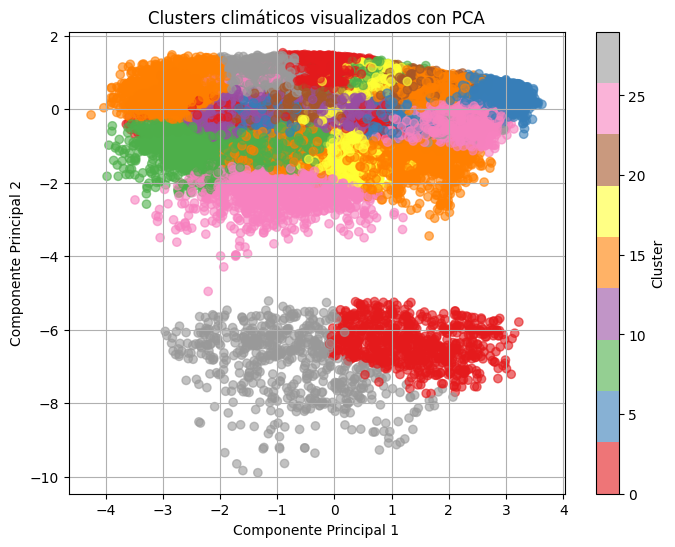

In [60]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Variables seleccionadas
features = ['Temperature (C)', 'Humidity', 'Wind Speed (km/h)', 'Visibility (km)', 'Pressure (millibars)']
X = data[features].dropna()

# Normalizar los datos
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# KMeans clustering
kmeans = KMeans(n_clusters=30, random_state=42)
clusters = kmeans.fit_predict(X_scaled)

# PCA para reducción a 2D
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)

# Graficar
plt.figure(figsize=(8,6))
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=clusters, cmap='Set1', alpha=0.6)
plt.title("Clusters climáticos visualizados con PCA")
plt.xlabel("Componente Principal 1")
plt.ylabel("Componente Principal 2")
plt.colorbar(label="Cluster")
plt.grid(True)
plt.show()


# K-Means

Aplicamos K-Means para Aprendizaje Semi-Supervisado

In [38]:
from sklearn.cluster import KMeans

k = 30
kmeans = KMeans(n_clusters=k, random_state=42)
X_digits_dist = kmeans.fit_transform(X_train)
print(X_digits_dist.shape)
print(X_digits_dist)

(86807, 30)
[[ 133.70194562 1014.64978136  306.16978035   20.2855176   176.73546151 1029.96989446  160.88955452   73.2458946     9.97528021  180.35301129  281.91719098  246.76558341  310.14462535 1056.91739857   47.8573295   190.77784863   33.03001232   40.77765615 1019.92495694  224.88052641   85.30353395   48.27084974  104.10350306  270.35056377  118.75218158   28.47008439  149.72681134  166.38976686  207.91164428   33.40951292]
 [  26.6198269  1022.39736459  155.40896295  132.18842412   33.41998133 1013.12287145   20.41850381   83.28781674  156.00822034   30.44120998  132.56241447   97.90640522  160.75162309 1023.20184874  113.57217327   42.60602003  150.37926518  177.12931681 1013.79574438   74.98682494   67.12885442  103.37036793   52.99946161  119.83847901   35.49395625  178.3738324    16.22078342   16.74747914   59.86563696  138.494552  ]
 [  79.3801858  1011.79154157  247.54816994   43.73082119  116.94043471 1017.22015697  105.05110282   34.49535979   66.92302268  121.9053765  

In [39]:
idxs = np.argmin(X_digits_dist, axis=0)
X_representative_digits = X_train.values[idxs]

print(X_representative_digits.shape)
print(X_representative_digits)

(30, 14)
[[2.7777777777777777 0.5277777777777793 0.82 8.05 190.0 9.016 0.0 1021.1 True False 3 0 0 0]
 [9.949999999999998 7.711111111111112 0.83 16.309300000000004 311.0 11.27 0.0 0.0 True False 2 0 0 0]
 [2.2222222222222223 -0.9277777777777788 0.93 11.2217 14.0 6.0858 0.0 1019.65 True False 3 0 0 0]
 [18.75 18.75 0.79 11.6081 299.0 11.27 0.0 1016.14 True False 2 0 0 0]
 [23.694444444444446 23.694444444444446 0.69 7.969500000000001 141.0 12.042800000000002 0.0 1013.35 True False 1 0 0 0]
 [13.88888888888889 13.88888888888889 0.9 12.799500000000002 140.0 8.05 0.0 0.0 True False 0 0 0 0]
 [2.894444444444445 0.2166666666666669 0.95 9.7566 160.0 7.1323 0.0 1021.22 True False 2 0 0 0]
 [5.044444444444443 3.18888888888889 0.6 8.05 253.0 9.982 0.0 1017.14 True False 2 0 0 0]
 [18.65555555555555 18.65555555555555 0.85 12.3004 323.0 10.948 0.0 1016.6 True False 2 0 0 0]
 [11.93333333333333 11.93333333333333 0.93 11.27 140.0 9.8049 0.0 1016.12 True False 1 0 0 0]
 [17.933333333333334 17.93333333

In [40]:
y_representative_digits = y_train.values[idxs]

In [43]:
from sklearn.linear_model import LogisticRegression


log_reg2 = LogisticRegression(multi_class="ovr", solver="lbfgs", max_iter=5000, random_state=42)

# Ensure y_representative_digits is reshaped to match the number of rows in X_representative_digits
# Ensure y_representative_digits is reshaped to match the number of rows in X_representative_digits
y_representative_digits_adjusted = np.array(y_representative_digits[:, -1], dtype=int)  # Use the last column (Season_Code) as labels

# Fit the logistic regression model
%time log_reg2.fit(X_representative_digits, y_representative_digits_adjusted)

# Evaluate the model
score = log_reg2.score(X_test, y_test["Season_Code"])  # Use the "Season_Code" column as labels
print("Model accuracy:", score)

c:\Users\GERMAN ZELAYA\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_logistic.py:1256: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. Use OneVsRestClassifier(LogisticRegression(..)) instead. Leave it to its default value to avoid this warning.
  warnings.warn(


CPU times: total: 234 ms
Wall time: 231 ms
Model accuracy: 0.420277835372175


c:\Users\GERMAN ZELAYA\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\utils\validation.py:2732: UserWarning: X has feature names, but LogisticRegression was fitted without feature names
  warnings.warn(


In [45]:
log_reg = LogisticRegression(multi_class="ovr", solver="lbfgs", max_iter=5000, random_state=42)

# Use the 'Season_Code' column as the target variable
%time log_reg.fit(X_train[:50], y_train["Season_Code"][:50])

# Evaluate the model using the 'Season_Code' column
score = log_reg.score(X_test, y_test["Season_Code"])
print("Model accuracy:", score)

c:\Users\GERMAN ZELAYA\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_logistic.py:1256: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. Use OneVsRestClassifier(LogisticRegression(..)) instead. Leave it to its default value to avoid this warning.
  warnings.warn(


CPU times: total: 328 ms
Wall time: 360 ms
Model accuracy: 0.5278872071324902


In [47]:
y_train_propagated = np.empty(len(X_train))
for i in range(k):
    # Assign only the Season_Code (last column) from y_representative_digits
    y_train_propagated[kmeans.labels_ == i] = y_representative_digits[i, -1]

In [49]:
# Ensure y_train_propagated contains only numeric values
y_train_propagated_numeric = np.array(y_train_propagated, dtype=int)

log_reg3 = LogisticRegression(multi_class="ovr", solver="lbfgs", max_iter=5000, random_state=42)
%time log_reg3.fit(X_train[:1000], y_train_propagated_numeric[:1000])
log_reg3.score(X_test, y_test["Season_Code"])  # Use the "Season_Code" column as labels

c:\Users\GERMAN ZELAYA\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_logistic.py:1256: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. Use OneVsRestClassifier(LogisticRegression(..)) instead. Leave it to its default value to avoid this warning.
  warnings.warn(
c:\Users\GERMAN ZELAYA\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. OF ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


CPU times: total: 1.92 s
Wall time: 1.9 s


0.43209620568111134

# Aprendizaje Activo

In [50]:
probas = log_reg3.predict_proba(X_train[:1000])
labels_ixs = np.argmax(probas, axis=1)
labels = np.array([proba[ix] for proba, ix in zip(probas, labels_ixs)])
sorted_ixs = np.argsort(labels)
labels[sorted_ixs[:10]]

array([0.27025885, 0.28638773, 0.30575487, 0.31308603, 0.31894547, 0.3193128 , 0.32020666, 0.32182439, 0.32347461, 0.32393856])

In [51]:
y_lowest = y_train.values[:1000][sorted_ixs[:k]]
y_lowest

array([[4, 'Primavera', 0],
       [10, 'Otoño', 2],
       [10, 'Otoño', 2],
       [4, 'Primavera', 0],
       [5, 'Primavera', 0],
       [5, 'Primavera', 0],
       [5, 'Primavera', 0],
       [11, 'Otoño', 2],
       [10, 'Otoño', 2],
       [10, 'Otoño', 2],
       [5, 'Primavera', 0],
       [3, 'Primavera', 0],
       [4, 'Primavera', 0],
       [8, 'Verano', 1],
       [6, 'Verano', 1],
       [5, 'Primavera', 0],
       [11, 'Otoño', 2],
       [9, 'Otoño', 2],
       [9, 'Otoño', 2],
       [11, 'Otoño', 2],
       [4, 'Primavera', 0],
       [9, 'Otoño', 2],
       [11, 'Otoño', 2],
       [5, 'Primavera', 0],
       [3, 'Primavera', 0],
       [5, 'Primavera', 0],
       [9, 'Otoño', 2],
       [5, 'Primavera', 0],
       [6, 'Verano', 1],
       [5, 'Primavera', 0]], dtype=object)

In [53]:
y_train2 = y_train_propagated[:1000].copy()
y_train2[sorted_ixs[:k]] = y_lowest[:, -1]  # Assign only the 'Season_Code' column

In [55]:
# Ensure y_train2 contains only numeric values
y_train2_numeric = np.array(y_train2, dtype=int)

log_reg5 = LogisticRegression(multi_class="ovr", solver="lbfgs", max_iter=5000, random_state=42)
%time log_reg5.fit(X_train[:1000], y_train2_numeric[:1000])
log_reg5.score(X_test, y_test["Season_Code"])  # Use the "Season_Code" column as labels

c:\Users\GERMAN ZELAYA\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_logistic.py:1256: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. Use OneVsRestClassifier(LogisticRegression(..)) instead. Leave it to its default value to avoid this warning.
  warnings.warn(
c:\Users\GERMAN ZELAYA\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. OF ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


CPU times: total: 1.69 s
Wall time: 1.7 s


0.4301264772962886